두개골 제거 전처리까지 추가한 버전

# Library install

In [1]:
pip install nibabel pandas numpy scipy openpyxl imageio

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: /Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


# Preprocessing

# 0. Import Library

In [2]:
import os
import imageio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import nibabel as nib
import cv2
from scipy.ndimage import zoom
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

## 1. Load Data

In [3]:
# 경로 설정
data_dir = "./newdata/"
save_dir = "./newdataset/"
excel_file_path = data_dir+"oasis_cross-sectional-excel.xlsx"

# 변환된 파일을 저장하는 디렉토리 설정
output_directory_gif = save_dir+"output_gif"
output_directory_nifti = save_dir+"output_nifti"

In [4]:
# 엑셀 파일에서 인구통계학적 정보를 데이터프레임으로 로드 - 모든 정보를 가져옴
df = pd.read_excel(excel_file_path)
df = df[['ID', 'M/F', 'Hand', 'Age', 'Educ', 'SES', 'MMSE', 'CDR', 'eTIV', 'nWBV', 'ASF', 'Delay']]

# CDR 값이 없는 경우, 결측값으로 간주하고 제거
df = df.dropna(subset=['CDR'])

In [5]:
# MRI, label, 인구통계 정보를 위한 리스트와 딕셔너리 생성
coronal_images = {}
sagittal_images = {}
transverse_images = {}
transverse_images_stripped = {}
transverse_images_masked = {}

labels = []
demographics = {}

In [6]:
# git에서 nifti로 변환하는 함수 
def convert_gif_to_nifti(gif_file):
    # GIF 파일을 읽고 모든 프레임을 이미지 배열로 변환
    gif_images = imageio.mimread(gif_file)  # 모든 프레임 읽기
    gif_array = np.array([np.array(img) for img in gif_images])  # 각 프레임을 numpy 배열로 변환

    # NIfTI 이미지 생성
    # GIF 배열의 차원 변경 (height, width, slices)
    gif_array = np.transpose(gif_array, (1, 2, 0))  # (slices, height, width)에서 (height, width, slices)로 변경

    nifti_img = nib.Nifti1Image(gif_array, affine=np.eye(4))  # 단위 행렬을 사용하여 affine 설정
    nifti_file = gif_file.replace('.gif', '.nii.gz')  # NIfTI 파일 이름 생성
    nib.save(nifti_img, nifti_file)  # NIfTI 파일로 저장
    return nifti_file

In [9]:
# nifti에서 gif로 변환하는 함수
def convert_nifti_to_gif(stripped_nifti_path, output_directory):
    # NIfTI 파일 읽기
    nifti_img = nib.load(stripped_nifti_path)
    data = nifti_img.get_fdata()  # NIfTI 이미지에서 데이터 추출

    # 출력 디렉토리 생성 (없으면)
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    gif_filenames = []  # 저장된 GIF 파일 이름 리스트

    # 각 슬라이스를 GIF로 저장
    for i in range(data.shape[2]):  # z축 방향으로 슬라이스 반복
        slice_data = data[:, :, i]  # i번째 슬라이스 추출
        slice_image = (slice_data * 255).astype(np.uint8)  # 픽셀 값을 0-255로 변환
        
        # GIF 파일 이름 생성
        gif_file = os.path.join(output_directory, f"slice_{i}.gif")
        
        # 슬라이스 이미지를 GIF로 저장
        imageio.imwrite(gif_file, slice_image)

        gif_filenames.append(gif_file)  # 저장된 GIF 파일 이름 추가
    
    # 첫 번째 슬라이스의 GIF 파일 경로 반환 (원하는 경우 다른 슬라이스로 변경 가능)
    return gif_filenames[0] if gif_filenames else None

In [10]:
# 이미지 크기 조정 함수 정의 (이미지를 224x224로 변환)
def resize_image(image, new_shape=(224, 224)):
    current_shape = image.shape[:2]  # 2D 이미지이므로 앞의 두 차원만 사용
    zoom_factors = [n / c for n, c in zip(new_shape, current_shape)]
    return zoom(image, zoom_factors)

In [11]:
# 두개골 제거 함수 
def apply_skull_stripping(nifti_file):
    # NIfTI 파일 읽기
    nifti_img = nib.load(nifti_file)
    data = nifti_img.get_fdata()  # 데이터 추출

    # 데이터에 대해 스컬 스트리핑을 수행
    stripped_data = np.zeros_like(data)
    
    for i in range(data.shape[2]):  # 각 슬라이스에 대해
        slice_data = data[:, :, i]  # 슬라이스 추출
        slice_data = (slice_data - np.min(slice_data)) / (np.max(slice_data) - np.min(slice_data)) * 255
        slice_data = slice_data.astype(np.uint8)

        # 이미지 이진화
        _, binary_slice = cv2.threshold(slice_data, 50, 255, cv2.THRESH_BINARY)

        # 윤곽선 찾기
        contours, _ = cv2.findContours(binary_slice, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        if contours:
            # 가장 큰 윤곽선 선택
            largest_contour = max(contours, key=cv2.contourArea)

            # 마스크 생성
            mask = np.zeros_like(binary_slice)
            cv2.drawContours(mask, [largest_contour], -1, 1, thickness=cv2.FILLED)

            # 슬라이스에 마스크 적용
            stripped_data[:, :, i] = slice_data * mask

    # NIfTI 이미지 생성
    stripped_nifti_img = nib.Nifti1Image(stripped_data, affine=nifti_img.affine)

    return stripped_nifti_img

In [14]:
# 사이즈, 형 변환 후 두개골 제거된 데이터를 저장하는 함수 
def preprocess(file_path, subject_dir, type, type_images): 
    # GIF 파일을 NIfTI 형식으로 변환
    nifti_file = convert_gif_to_nifti(file_path)
    print("nifti transform done")

    # Skull stripping 적용 (두개골 제거)
    stripped_img = apply_skull_stripping(nifti_file)
    print("skull stripping done")
    
    # 피험자별 폴더 경로 설정
    subject_output_dir = os.path.join(output_directory_nifti, subject_dir)

    # 피험자 별 폴더 생성
    subject_output_dir = os.path.join(output_directory_nifti, subject_dir)
    if not os.path.exists(subject_output_dir):
        os.makedirs(subject_output_dir)

    # 두개골 제거 후 결과를 NIfTI 파일로 저장
    stripped_nifti_path = os.path.join(subject_output_dir, f"{subject_dir}_stripped_{type}.nii.gz")
    nib.save(stripped_img, stripped_nifti_path)

    # NIfTI 파일을 GIF로 변환
    gif_file = convert_nifti_to_gif(stripped_nifti_path, output_directory_gif)

    # 변환된 GIF 이미지를 다시 로드
    transformed_image = imageio.v2.imread(gif_file, mode='L')
    resized_image = resize_image(transformed_image)
    
    type_images[subject_dir] = resized_image

In [15]:
# 피험자 ID와 df 값을 매칭하여 딕셔너리에 저장하는 함수
def save_dictionary(subject_id):
    # 엑셀에서 해당 ID를 매칭하고 정보를 찾기
    subject_info = df[df['ID'] == subject_id]

    if not subject_info.empty:
        # CDR 값을 label로 사용
        cdr_value = subject_info['CDR'].values[0]
        labels.append(cdr_value)

        # 인구통계학적 정보 딕셔너리에 저장
        demographics[subject_id] = {
            'M/F': subject_info['M/F'].values[0],
            'Hand': subject_info['Hand'].values[0],
            'Age': subject_info['Age'].values[0],
            'Educ': subject_info['Educ'].values[0],
            'SES': subject_info['SES'].values[0],
            'MMSE': subject_info['MMSE'].values[0],
            'eTIV': subject_info['eTIV'].values[0],
            'nWBV': subject_info['nWBV'].values[0],
            'ASF': subject_info['ASF'].values[0],
            'Delay': subject_info['Delay'].values[0]
        }
    else:
        print(f"Label not found for subject: {subject_id}")  # label이 없는 피험자 출력

In [16]:
# 피험자 데이터 로드 및 저장
for disc_num in range(1, 13):  # 1~12 디스크 (OASIS 디스크 12개)
    disc_path = os.path.join(data_dir, f"oasis_cross-sectional_disc{disc_num}")

    # [디버깅] 디스크 경로가 존재하는지 확인
    if not os.path.exists(disc_path):
        print(f"Disc path does not exist: {disc_path}")
        continue

    for sub_folder in os.listdir(disc_path):  # disc 안의 폴더 탐색
        sub_folder_path = os.path.join(disc_path, sub_folder)

        if not os.path.isdir(sub_folder_path):  # [디버깅] 폴더가 아닌 경우 무시
            print(f"Skipping non-directory: {sub_folder_path}")
            continue

        for subject_dir in os.listdir(sub_folder_path):  # 피험자 폴더 탐색
            subject_path = os.path.join(sub_folder_path, subject_dir)

            if not os.path.isdir(subject_path): # [디버깅] 폴더가 아닌 경우 무시
                print(f"Skipping non-directory: {subject_path}")
                continue

            # MR1 경로 설정
            session_path = subject_path
            print(f"Processing session: {session_path}")

            if not os.path.exists(session_path): # [디버깅]
                print(f"Session path does not exist: {session_path}")
                continue

            # preprocessed 데이터 경로 (T88_111 폴더)
            t88_111_path = os.path.join(session_path, "PROCESSED", "MPRAGE", "T88_111")
            print(f"Checking T88_111 path: {t88_111_path}")

            if os.path.exists(t88_111_path):
                for file in os.listdir(t88_111_path):
                    file_path = os.path.join(t88_111_path, file)

                    # coronal 이미지 처리
                    if file.endswith("_cor_110.gif"):
                        print(f"Loading coronal .gif file: {file_path}")
                        try:
                            img = imageio.v2.imread(file_path)
                            img_resized = resize_image(img)
                            coronal_images[subject_dir] = img_resized
                        except Exception as e: # [디버깅]
                            print(f"Error loading coronal image: {e}")

                    # sagittal 이미지 처리
                    elif file.endswith("_sag_95.gif"):
                        print(f"Loading sagittal .gif file: {file_path}")
                        try:
                            img = imageio.v2.imread(file_path)
                            img_resized = resize_image(img)
                            sagittal_images[subject_dir] = img_resized
                        except Exception as e: # [디버깅]
                            print(f"Error loading sagittal image: {e}")

                    # transverse 이미지 처리
                    elif file.endswith("_tra_90.gif"):
                        # masked 데이터 불러오기
                        if "masked_gfc" in file:
                            print(f"Loading masked transverse .gif file: {file_path}", transverse_images_masked)
                            try:
                                img = imageio.v2.imread(file_path)
                                img_resized = resize_image(img)
                                transverse_images_masked[subject_dir] = img_resized
                            except Exception as e: # [디버깅]
                                print(f"Error loading masked transverse image: {e}")

                        # raw 데이터 불러오기
                        print(f"Loading regular transverse .gif file: {file_path}")
                        try:
                            img = imageio.v2.imread(file_path)
                            img_resized = resize_image(img)
                            transverse_images[subject_dir] = img_resized
                        except Exception as e: # [디버깅]
                            print(f"Error loading regular transverse image: {e}")

                        # 두개골 제거 데이터 
                        print(f"Loading regular transverse .gif file: {file_path}")
                        try:
                            preprocess(file_path, subject_dir, "tra", transverse_images_stripped)
                        except Exception as e: #[디버깅]
                            print(f"Error loading regular transverse image: {e}")
    
                    # 피험자 ID 그대로 추출
                    subject_id = subject_dir

                    # 피험자 ID와 엑셀 파일상 데이터 매칭하여 딕셔너리에 저장
                    save_dictionary(subject_id)
            else:
                print(f"T88_111 path does not exist: {t88_111_path}")

Skipping non-directory: ./newdata/oasis_cross-sectional_disc1/disc1/.DS_Store
Processing session: ./newdata/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1
Checking T88_111 path: ./newdata/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111
Loading masked transverse .gif file: ./newdata/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111/OAS1_0016_MR1_mpr_n3_anon_111_t88_masked_gfc_tra_90.gif {}
Loading regular transverse .gif file: ./newdata/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111/OAS1_0016_MR1_mpr_n3_anon_111_t88_masked_gfc_tra_90.gif
Loading regular transverse .gif file: ./newdata/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111/OAS1_0016_MR1_mpr_n3_anon_111_t88_masked_gfc_tra_90.gif
nifti transform done
skull stripping done
Loading coronal .gif file: ./newdata/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111/OAS1_0016_MR1_mpr_n3_anon_111_t88_gfc_cor_110.gif
Loa

## 2. Preprocessing

### 1) 결측치 처리

label와 mri가 동시에 존재하는 피실험자만 데이터셋으로 사용하기

In [17]:
valid_subjects = [subject for subject in demographics if subject in df['ID'].values]
coronal_images = {subject: coronal_images[subject] for subject in valid_subjects if subject in coronal_images}
sagittal_images = {subject: sagittal_images[subject] for subject in valid_subjects if subject in sagittal_images}
transverse_images = {subject: transverse_images[subject] for subject in valid_subjects if subject in transverse_images}
transverse_images_stripped = {subject: transverse_images_stripped[subject] for subject in valid_subjects if subject in transverse_images_stripped}
transverse_images_masked = {subject: transverse_images_masked[subject] for subject in valid_subjects if subject in transverse_images_masked}

# 라벨
labels = [df[df['ID'] == subject]['CDR'].values[0] for subject in valid_subjects]

In [18]:
# 최종 저장된 정보 출력
print(f"Coronal images: {len(coronal_images)}")
print(f"Sagittal images: {len(sagittal_images)}")
print(f"Regular transverse images: {len(transverse_images)}")
print(f"Stripped transverse images: {len(transverse_images_stripped)}")
print(f"Masked transverse images: {len(transverse_images_masked)}\n")

# 라벨 출력
print(f"Total labels: {len(labels)}")

print(f"저장된 피험자 수: {len(demographics)}")

Coronal images: 235
Sagittal images: 235
Regular transverse images: 235
Stripped transverse images: 235
Masked transverse images: 235

Total labels: 235
저장된 피험자 수: 235


### 2) Label encoding

In [19]:
def convert_images_to_array(image_dict):
    image_array = []
    for img in image_dict.values():
        # if 이미지가 흑백인 경우 : 채널을 추가하는 코드 - 모델에 입력 가능한 형태인 (height, width, 1)로 맞춤
        if len(img.shape) == 2:
            img = np.expand_dims(img, axis=-1)
        image_array.append(img)
    return np.array(image_array)

In [20]:
# 전체 치매군과 비치매군 인원수 출력
dementia_count = sum([1 if cdr >= 0.5 else 0 for cdr in labels])
non_dementia_count = len(labels) - dementia_count
print(f"Total Dementia: {dementia_count}, Total Non-dementia: {non_dementia_count}")

Total Dementia: 100, Total Non-dementia: 135


In [21]:
# 비치매군을 치매군의 개수에 맞게 랜덤 추출 (과적합 방지를 위해)
non_dementia_subjects = [subject for subject, cdr in zip(valid_subjects, labels) if cdr == 0]
np.random.seed(42)
non_dementia_subjects_balanced = np.random.choice(non_dementia_subjects, size=dementia_count, replace=False).tolist()

In [22]:
# 치매군과 밸런스맞춘 비치매군의 데이터셋을 합침
dementia_subjects = [subject for subject, cdr in zip(valid_subjects, labels) if cdr >= 0.5]
balanced_subjects = dementia_subjects + non_dementia_subjects_balanced

In [28]:
print(len(dementia_subjects))
print(len(balanced_subjects))

100
200


In [29]:
# label 1은 치매, label 0은 비치매로 설정
balanced_labels = [1] * len(dementia_subjects) + [0] * len(non_dementia_subjects_balanced)

### 3) Split Data

In [60]:
# 데이터셋을 train/validation/test로 분할
train_subjects, temp_subjects, train_labels, temp_labels = train_test_split(
    balanced_subjects, balanced_labels, test_size=0.4, stratify=balanced_labels, random_state=42
)

val_subjects, test_subjects, val_labels, test_labels = train_test_split(
    temp_subjects, temp_labels, test_size=0.5, stratify=temp_labels, random_state=42
)

In [61]:
# 각 세트에 맞는 이미지들 준비 (coronal, sagittal, transverse, transverse_masked)
train_coronal = convert_images_to_array({subject: coronal_images[subject] for subject in train_subjects if subject in coronal_images})
val_coronal = convert_images_to_array({subject: coronal_images[subject] for subject in val_subjects if subject in coronal_images})
test_coronal = convert_images_to_array({subject: coronal_images[subject] for subject in test_subjects if subject in coronal_images})

train_sagittal = convert_images_to_array({subject: sagittal_images[subject] for subject in train_subjects if subject in sagittal_images})
val_sagittal = convert_images_to_array({subject: sagittal_images[subject] for subject in val_subjects if subject in sagittal_images})
test_sagittal = convert_images_to_array({subject: sagittal_images[subject] for subject in test_subjects if subject in sagittal_images})

train_transverse = convert_images_to_array({subject: transverse_images[subject] for subject in train_subjects if subject in transverse_images})
val_transverse = convert_images_to_array({subject: transverse_images[subject] for subject in val_subjects if subject in transverse_images})
test_transverse = convert_images_to_array({subject: transverse_images[subject] for subject in test_subjects if subject in transverse_images})

train_transverse_stripped = convert_images_to_array({subject: transverse_images[subject] for subject in train_subjects if subject in transverse_images_stripped})
val_transverse_stripped = convert_images_to_array({subject: transverse_images[subject] for subject in val_subjects if subject in transverse_images_stripped})
test_transverse_stripped = convert_images_to_array({subject: transverse_images[subject] for subject in test_subjects if subject in transverse_images_stripped})

train_transverse_masked = convert_images_to_array({subject: transverse_images_masked[subject] for subject in train_subjects if subject in transverse_images_masked})
val_transverse_masked = convert_images_to_array({subject: transverse_images_masked[subject] for subject in val_subjects if subject in transverse_images_masked})
test_transverse_masked = convert_images_to_array({subject: transverse_images_masked[subject] for subject in test_subjects if subject in transverse_images_masked})


In [62]:
# 정규화 함수 정의 (이미지의 픽셀 값을 0에서 1 사이로 정규화)
def normalize_image(image):
    # 이미지의 최대값이 0이 아니어야 정규화를 진행
    if image.max() > 0:
        return image / 255.0
    else:
        return image

# 정규화 적용 및 정규화 전후 값 출력 [디버깅]
def normalize_and_compare(image_array, image_type):
    print(f"Before Normalization: {image_type} Min={image_array.min()}, Max={image_array.max()}")
    normalized_images = normalize_image(image_array)
    print(f"After Normalization: {image_type} Min={normalized_images.min()}, Max={normalized_images.max()}")
    return normalized_images

## 4. normalization

In [63]:
# 이미지 배열에 정규화 적용
train_coronal = normalize_and_compare(train_coronal, 'Train Coronal')
val_coronal = normalize_and_compare(val_coronal, 'Validation Coronal')
test_coronal = normalize_and_compare(test_coronal, 'Test Coronal')

train_sagittal = normalize_and_compare(train_sagittal, 'Train Sagittal')
val_sagittal = normalize_and_compare(val_sagittal, 'Validation Sagittal')
test_sagittal = normalize_and_compare(test_sagittal, 'Test Sagittal')

train_transverse = normalize_and_compare(train_transverse, 'Train Transverse')
val_transverse = normalize_and_compare(val_transverse, 'Validation Transverse')
test_transverse = normalize_and_compare(test_transverse, 'Test Transverse')

train_transverse_stripped = normalize_and_compare(train_transverse_stripped, 'Train Transverse_stripped')
val_transverse_stripped = normalize_and_compare(val_transverse_stripped, 'Validation Transverse_stripped')
test_transverse_stripped = normalize_and_compare(test_transverse_stripped, 'Test Transverse_stripped')

train_transverse_masked = normalize_and_compare(train_transverse_masked, 'Train Transverse Masked')
val_transverse_masked = normalize_and_compare(val_transverse_masked, 'Validation Transverse Masked')
test_transverse_masked = normalize_and_compare(test_transverse_masked, 'Test Transverse Masked')

Before Normalization: Train Coronal Min=0, Max=255
After Normalization: Train Coronal Min=0.0, Max=1.0
Before Normalization: Validation Coronal Min=0, Max=255
After Normalization: Validation Coronal Min=0.0, Max=1.0
Before Normalization: Test Coronal Min=0, Max=255
After Normalization: Test Coronal Min=0.0, Max=1.0
Before Normalization: Train Sagittal Min=0, Max=248
After Normalization: Train Sagittal Min=0.0, Max=0.9725490196078431
Before Normalization: Validation Sagittal Min=0, Max=247
After Normalization: Validation Sagittal Min=0.0, Max=0.9686274509803922
Before Normalization: Test Sagittal Min=0, Max=243
After Normalization: Test Sagittal Min=0.0, Max=0.9529411764705882
Before Normalization: Train Transverse Min=0, Max=235
After Normalization: Train Transverse Min=0.0, Max=0.9215686274509803
Before Normalization: Validation Transverse Min=0, Max=243
After Normalization: Validation Transverse Min=0.0, Max=0.9529411764705882
Before Normalization: Test Transverse Min=0, Max=225
Afte

In [64]:
# 최종 데이터셋 출력
print(f"Train set: {len(train_subjects)} subjects (Dementia: {sum(train_labels)}, Non-dementia: {len(train_labels) - sum(train_labels)})")
print(f"Validation set: {len(val_subjects)} subjects (Dementia: {sum(val_labels)}, Non-dementia: {len(val_labels) - sum(val_labels)})")
print(f"Test set: {len(test_subjects)} subjects (Dementia: {sum(test_labels)}, Non-dementia: {len(test_labels) - sum(test_labels)})")

Train set: 120 subjects (Dementia: 60, Non-dementia: 60)
Validation set: 40 subjects (Dementia: 20, Non-dementia: 20)
Test set: 40 subjects (Dementia: 20, Non-dementia: 20)


### 5) save file

In [65]:
# 이미지 배열 저장
file_types = ['train', 'val', 'test']
image_types = ['coronal', 'sagittal', 'transverse', 'transverse_stripped', 'transverse_masked']

for image_type in image_types:
    for file_type in file_types:
        np.save(save_dir + f"{file_type}_{image_type}.npy", eval(f"{file_type}_{image_type}"))
        
# label 저장
for file_type in file_types:
    np.save(save_dir+ f"{file_type}_labels.npy", eval(f"{file_type}_labels"))

# Visualising

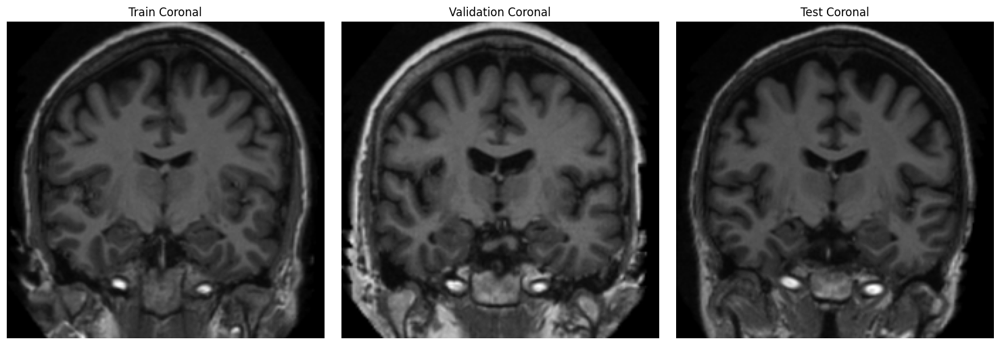

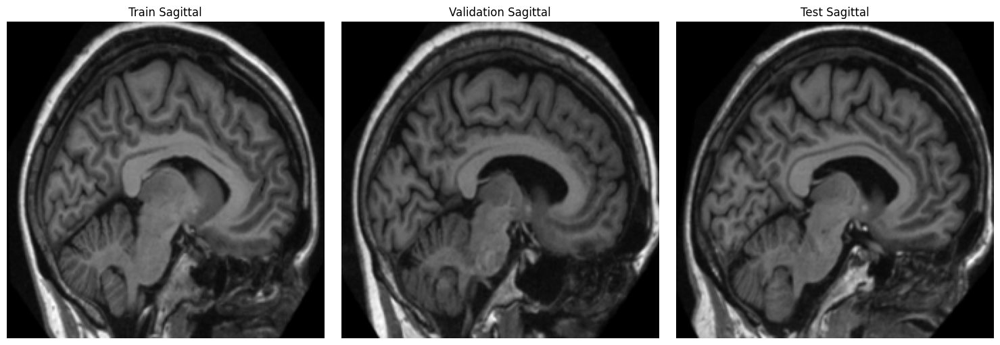

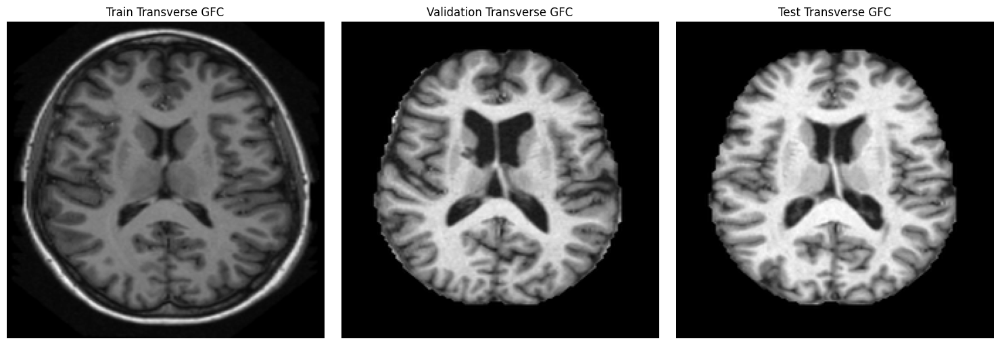

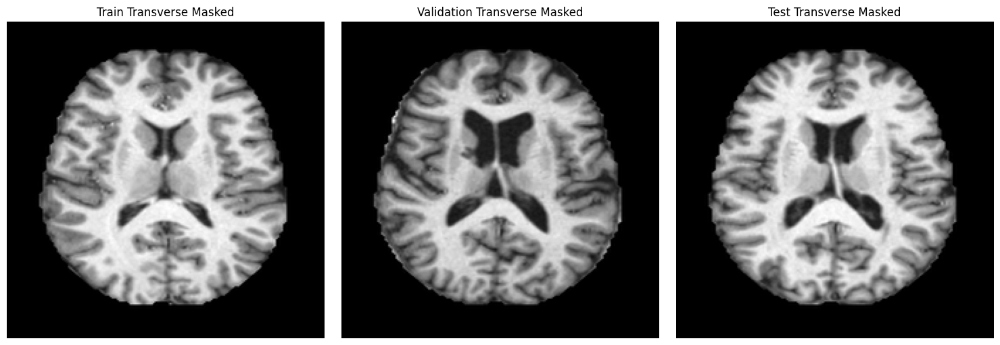

In [54]:
# 이미지 시각화 함수 정의
def display_sample_images(image_arrays, titles, cmap='gray'):
    # 이미지 배열과 제목 리스트의 길이가 같아야 함
    assert len(image_arrays) == len(titles)

    plt.figure(figsize=(15, 5))
    for i, (image, title) in enumerate(zip(image_arrays, titles)):
        plt.subplot(1, len(image_arrays), i+1)
        plt.imshow(image.squeeze(), cmap=cmap)
        plt.title(title)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# 샘플 이미지를 시각화 (정규화된 이미지 확인)
def visualize_samples():
    # Coronal, Sagittal, Transverse 2종 각각 첫 번째 샘플 이미지 시각화
    sample_coronal = [train_coronal[0], val_coronal[0], test_coronal[0]]
    sample_sagittal = [train_sagittal[0], val_sagittal[0], test_sagittal[0]]
    sample_transverse_gfc = [train_transverse[0], val_transverse[0], test_transverse[0]]
    sample_transverse_masked = [train_transverse_masked[0], val_transverse_masked[0], test_transverse_masked[0]]

    # Coronal 이미지 시각화
    display_sample_images(sample_coronal, ["Train Coronal", "Validation Coronal", "Test Coronal"])

    # Sagittal 이미지 시각화
    display_sample_images(sample_sagittal, ["Train Sagittal", "Validation Sagittal", "Test Sagittal"])

    # Transverse GFC 이미지 시각화
    display_sample_images(sample_transverse_gfc, ["Train Transverse GFC", "Validation Transverse GFC", "Test Transverse GFC"])

    # Transverse Masked 이미지 시각화
    display_sample_images(sample_transverse_masked, ["Train Transverse Masked", "Validation Transverse Masked", "Test Transverse Masked"])

# 샘플 이미지 시각화 실행
visualize_samples()
